In [1]:
from DarkNews import const
from DarkNews import Cfourvec as Cfv
import DarkNews as dn
from DarkNews import GenLauncher
import importlib.resources as resources
import matplotlib.pyplot as plt
from examples_old import ToyAnalysis
from examples_old.ToyAnalysis import analysis_decay
import plotly as plotly
import numpy as np
from numpy.random import choice
import pandas as pd
import plotly.express as px
from plotly.graph_objects import Layout
import uproot
import ToyAnalysis.analysis_decay as an


import plotly.io as pio
pio.renderers.default = "vscode"


In [18]:
# Defining NuMI beam parameters in cm
NuMI_decay_pipe_radius = 1e2 # cm, from https://ar5iv.labs.arxiv.org/html/1507.06690
NuMI_decay_pipe_length = 675e2 # cm, from https://ar5iv.labs.arxiv.org/html/1507.06690
NuMI_full_length = 10e2 + 30e2 + NuMI_decay_pipe_length + 2.5e2 # cm, corresponding to 10m horn 1, 30m horn 2, 675m decay pipe, 2.5m absorber

NuMI_target = [0,0,0]
NuMI_absorber = [0,0, NuMI_full_length]

# Matrix to convert from NuMI beam cooridinates to the uBooNE detector coordinates
numi_coord_matrix =    np.array([
                        [ 0.9210385380402568, 0.0227135048039241207, 0.38880857519374290 ],
	                    [0.0000462540012621546684, 0.99829162468141475, -0.0584279894529063024],
                        [-0.38947144863934974, 0.0538324139386641073, 0.91946400794392302 ]
                        ])

# Position of the uBooNE detector in NuMI beam coordinates
ub_beam_coords = np.array([5502, 7259, 67270]) # cm

# Timing offsets defined in uboone docdb 12290
uBNuMIGlobalTimeOffset = 4687.5
uBNuMIRandomTimeOffset = 9600

# Importing NuMI flux files
# Energy vs baseline distribution
NuMI_energies_positions = np.genfromtxt('NuMI_energy_distances.dat', delimiter=' ', skip_header=0)
NuMI_energy_nu = NuMI_energies_positions[1:,0]
NuMI_distances_nu = NuMI_energies_positions[0,1:]
NuMI_e_vs_dist = NuMI_energies_positions[1:,1:]
NuMI_enu_max = np.max(NuMI_energy_nu)
# Angle-energy flux normalization
NuMI_fluxes = np.genfromtxt('NuMI_angle_energy_normalization.dat', delimiter=' ', skip_header=0)
NuMI_e_bins_angle = NuMI_fluxes[1:,0]
NuMI_th_bins_angle = NuMI_fluxes[0,1:]
NuMI_e_vs_angle = NuMI_fluxes[1:,1:]
# Neutrino angle (from NuMI beam) distribution
NuMI_angle_dist = np.genfromtxt('NuMI_angle_flux.dat', delimiter=' ', skip_header=0)
NuMI_angle_bins = NuMI_angle_dist[0,:]
NuMI_angle_dist = NuMI_angle_dist[1,:]

angle_flux_min = minval = np.min(NuMI_angle_dist[np.nonzero(NuMI_angle_dist)])
NuMI_angle_dist = NuMI_angle_dist / angle_flux_min

file_run0 = uproot.open('output_uboone_fhc_run0_set1.root')
base_line_hist = file_run0['numu/Detsmear/Baseline_numu_CV_TPC;1']
baseline_hist, baseline_bins = base_line_hist.to_numpy()

In [19]:
################## ROTATION FUNCTIONS ######################
def dot3(p1, p2):
    return p1[0]*p2[0] + p1[1]*p2[1] + p1[2]*p2[2]

def normalize_3D_vec(v):
    return v / np.sqrt(dot3(v,v))

def cross3(p1, p2):
    px = p1[1]*p2[2] - p1[2]*p2[1]
    py = p1[2]*p2[0] - p1[0]*p2[2]
    pz = p1[0]*p2[1] - p1[1]*p2[0]
    return np.array([px,py,pz])

# rotate v by an angle of theta on the plane perpendicular to k using Rodrigues' rotation formula
def rotate_by_theta(v,k,theta):
    # we first normalize k
    k = normalize_3D_vec(k)
    
    # Rodrigues' rotation formula
    return np.cos(theta) * v + np.sin(theta) * cross3(k,v) + dot3(k,v) * (1 - np.cos(theta)) * k


# rotate a 3D-vector v using the same minimum rotation to take vector a into vector b
def rotate_similar_to(v,a,b):
    # normalize vectors a and b
    a = normalize_3D_vec(a)
    b = normalize_3D_vec(b)
    
    # compute normal vector to those and angle
    k = cross3(a,b)
    theta = np.arccos(dot3(a,b))
    
    # use previous function to compute new vector
    return rotate_by_theta(v,k,theta)

def rotate_dataframe(df):
    particles = ['P_target','P_recoil','P_decay_N_parent','P_decay_ell_plus','P_decay_ell_minus','P_decay_N_daughter','P_decay_photon','P_projectile']

    for particle in particles:
        try:
            df.loc[:,(particle,['1','2','3'])] = rotate_similar_to(df[particle].to_numpy().T[1:],df.P_projectile.to_numpy().T[1:],df.pos_scatt.to_numpy().T[1:] - df['pos_prod'].to_numpy().T).T
        except:
            continue

    return df

In [20]:
def convert_to_numi_beam_coords(x):
    matrix = np.linalg.inv(numi_coord_matrix)
    x = np.array(x)
    x = np.matmul(matrix,x.T).T
    x += ub_beam_coords
    return x

def convert_to_ub_tpc_coords(x):
    x = np.array(x)
    x -= ub_beam_coords
    x = np.matmul(numi_coord_matrix,x.T).T
    return x

In [21]:
kwargs_numi = {  
        'neval': 1e5,
        'HNLtype': 'dirac',
        # 'hepevt': True,
        # 'unweighted_hep_events': 1000,
        # 'hep_unweight': True,
        'experiment': 'microboone_numi_fhc',
        'nopelastic': True,
        'pandas': False,
        'loglevel': 'WARNING'
        }
gen_object = GenLauncher(mzprime=0.030, m4=0.150, **kwargs_numi)
gen_object.run()
numi_df = gen_object.df

Directory tree for this run already exists. Overriding it.


In [22]:
def nearest_point_to_ub(scatt_pos):

    beam_vec = np.subtract(NuMI_absorber, NuMI_target)
    beam_hat = beam_vec / np.linalg.norm(beam_vec)

    BNB_vec = np.array([[0,0,0],[0,0,1]])
    BNB_vec = convert_to_numi_beam_coords(BNB_vec)
    BNB_vec = np.subtract(BNB_vec[1], BNB_vec[0])

    # Get the point on the beam closest to the scattering point
    p1_vec = scatt_pos - NuMI_target
    p1_len = np.linalg.norm(p1_vec)
    p1_hat = p1_vec / p1_len

    cos_theta = np.dot(p1_hat, beam_hat)
    scale = cos_theta * p1_len
    scale = np.tile(scale, (3,1)).T

    return (beam_hat * scale)


def neutrino_nan(E_nu):
    final_angles = []
    for i in range(len(E_nu)):
        e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu[i], side='right')-1
        probs_angle = np.ones_like(NuMI_e_vs_angle)

        for j in range(np.shape((probs_angle))[1]):
            arr = np.asarray([NuMI_e_vs_angle.T[:,e_bins]])
            if arr.sum() != 0:
                probs_angle[j] = arr
        neutrino_angle = choice(NuMI_th_bins_angle, 1, p=probs_angle[e_bins] / probs_angle[e_bins].sum())[0]
        final_angles.append(neutrino_angle)
    return final_angles

def neutrino_random(angle,E_nu):
    e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu, side='right')-1
    angle_hist = NuMI_e_vs_angle.T[:,e_bins]

    th_bin_1 = np.searchsorted(NuMI_angle_bins, angle, side='right')-1
    th_bin_2 = np.searchsorted(NuMI_angle_bins, 180-angle, side='right')-1

    th_arr = []
    weight_arr = []
    
    search_range = 9
    offset = search_range//2 +1
    for j in range(search_range):
        th_arr.append(NuMI_angle_bins[th_bin_1 +j - 4])
        th_arr.append(NuMI_angle_bins[th_bin_2 +j - 4])
        
        weight_arr.append(NuMI_angle_dist[th_bin_1 +j - 4])
        weight_arr.append(NuMI_angle_dist[th_bin_2 +j - 4])

    th_arr = np.array(th_arr).T
    weight_arr = np.array(weight_arr).T

    sum = np.sum(weight_arr, axis=1)
    sum = np.tile(sum, (2*search_range, 1)).T
    weights = np.array(weight_arr) / sum

    if np.isnan(weights).any():
        print(weights)
    else: print('success')

    th_arr = np.array(th_arr)
    return  [choice(th_arr[i], 1, p=weights[i])[0] for i in range(len(E_nu))]

def neutrino_nan_random_split(angle, E_nu):
    return np.where(np.isnan(angle) == True, neutrino_nan(E_nu), neutrino_random(angle, E_nu))


def get_neutrino_angle(scatt_pos, length, E_nu):

    scatt_pos = convert_to_numi_beam_coords(scatt_pos)
    nearest_point = nearest_point_to_ub(scatt_pos)
    
    dist = np.linalg.norm(scatt_pos - nearest_point, axis=1)

    sin_theta = dist/length

    theta = np.arcsin(sin_theta)
    theta = np.rad2deg(theta)

    limit_absorber = np.linalg.norm(scatt_pos - NuMI_absorber, axis=1)

    angle_limit_absorber = np.arcsin(np.linalg.norm(scatt_pos - nearest_point, axis=1)/limit_absorber)
    angle_limit_absorber = np.rad2deg(angle_limit_absorber) - 15

    limit_target = np.linalg.norm(scatt_pos - NuMI_target, axis=1)
    angle_limit_target = np.arcsin(np.linalg.norm(scatt_pos - nearest_point, axis=1)/limit_target)
    angle_limit_target = np.rad2deg(angle_limit_target)

    final_angles = []

    n_nan = 0
    n_random = 0
    n_intended = 0

    w1 = []
    w2 = []

    angle_1 = []
    angle_2 = []

    for i, angle in enumerate(theta):

        if angle < angle_limit_absorber[i]:
            final_angles.append(angle)
            n_intended += 1
        elif np.isnan(angle) == True:
            # Sampling the neutrino angle given the energy
            n_Ebins = 100
            e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu[i], side='right')-1
            probs_angle = np.ones_like(NuMI_e_vs_angle)

            for j in range(np.shape((probs_angle))[1]):
                arr = np.asarray([NuMI_e_vs_angle.T[:,e_bins]])
                if arr.sum() != 0:
                    probs_angle[j] = arr
            neutrino_angle = choice(NuMI_th_bins_angle, 1, p=probs_angle[e_bins] / probs_angle[e_bins].sum())[0]
            final_angles.append(neutrino_angle)
            n_nan += 1
        else:
            e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu[i], side='right')-1
            angle_hist = NuMI_e_vs_angle.T[:,e_bins]

            th_bin_1 = np.searchsorted(NuMI_angle_bins, angle, side='right')-1
            th_bin_2 = np.searchsorted(NuMI_angle_bins, 180-angle, side='right')-1

            th_arr = []
            weight_arr = []
            
            search_range = 5
            offset = search_range//2 +1

            for j in range(search_range):
                th_arr.append(NuMI_angle_bins[th_bin_1 +j - 4])
                th_arr.append(NuMI_angle_bins[th_bin_2 +j - 4])
                
                weight_arr.append(NuMI_angle_dist[th_bin_1 +j - 4])
                weight_arr.append(NuMI_angle_dist[th_bin_2 +j - 4])

            sum = np.sum(weight_arr)
            weights = np.array(weight_arr)/sum

            final_angles.append(choice(th_arr, 1, p=weights)[0])
            n_random += 1

    print(f'Intended: {n_intended}, Random: {n_random}, NaN: {n_nan}')

    x = dist / np.tan(np.deg2rad(final_angles))

    beam_hat = [0,0,1]
    x_pos = nearest_point - x[:,np.newaxis] * beam_hat

    return final_angles, x_pos


In [23]:
def microboone_NuMI_geometry(df):

    length_events = len(df.index)
    nsamples = len(df.index)

    detector_box = np.array([[-200, 200], [-200, 200], [-800, 800]])

    tries = 0
    npoints = 0
    events = np.array(3 * [[]])
    while npoints < nsamples:

        new_detector = dn.geom.Chisel(nsamples=nsamples, box=detector_box)
        new_events = new_detector.events[:, new_detector.microboone_cryostat()]
        events = np.concatenate((events, new_events), axis=1)

        npoints += np.shape(new_events)[1]
        tries += nsamples
        if tries > 1e3 * nsamples:
            raise ValueError("Geometry sampled too inefficiently. Wrong setup?")

    # Parameters from Mark -- neutrino time spill, overlapping w Genie BNB
    time = uBNuMIGlobalTimeOffset + (uBNuMIRandomTimeOffset) * np.random.rand(nsamples)

    # guarantee that array has number of samples asked (nsamples)
    df["pos_scatt", "0"] = time
    df["pos_scatt", "1"] = events[0, :nsamples]
    df["pos_scatt", "2"] = events[1, :nsamples]
    df["pos_scatt", "3"] = events[2, :nsamples]
    
    # Sampling the distance given the energy
    n_Lbins =  len(NuMI_distances_nu)
    E_nu = df["P_projectile","0"].values
    e_bins = np.searchsorted(NuMI_energy_nu, E_nu, side='right')-1

    bin_width = np.diff(NuMI_energy_nu)
    probs_distance = np.ones_like(NuMI_e_vs_dist)

    for i in range(np.shape((probs_distance))[0]):
        arr = np.asarray([NuMI_e_vs_dist.T[:,e_bins[i]]])
        if arr.sum() != 0:
            probs_distance[i] = arr
    
    diffs = np.diff(NuMI_distances_nu)
    diffs = np.append(diffs, diffs[-1])
    # Assuming distances are uniformly distributed within the bin, we distribute them across the bin.
    distances = np.array([choice(NuMI_distances_nu, 1, p=probs_distance[e_bins[i]] / probs_distance[e_bins[i]].sum())[0] + np.random.random()*diffs[e_bins[i]]-diffs[e_bins[i]]/2  for i in range(nsamples)])*1e2

    df['distance'] = distances
    
    # Calculating the production point, given distance

    scatt_pos = np.array([df['pos_scatt', '1'].to_numpy(), df['pos_scatt', '2'].to_numpy(), df['pos_scatt', '3'].to_numpy()]).T

    neutrino_angle, prod_pos = get_neutrino_angle(scatt_pos, distances, df['P_projectile','0'].to_numpy())
    prod_pos = convert_to_ub_tpc_coords(prod_pos)
    
    df["pos_prod", "1"] = prod_pos[:,0]
    df["pos_prod", "2"] = prod_pos[:,1]
    df["pos_prod", "3"] = prod_pos[:,2]    
    df['neutrino_angle'] = neutrino_angle
    
    # RESCALE WEIGHTS
    # rescale the weights with respect to the distance
    # l_baseline_muB - origin is the distance from the horn to the production point
    # try using NuMI_decay_pipe_length - beamline_intersection[:,2] instead ???
    
    # distance_weight = ((NuMI_full_length - prod_point[:,2]) / baseline)**2
    numi_vector = np.array([[0,0,0] , [0,0,NuMI_full_length]])
    numi_vector = convert_to_ub_tpc_coords(numi_vector)
    numi_vector = np.subtract(numi_vector[1], numi_vector[0])
    decay_pipe_dist = np.linalg.norm(numi_vector)
    distance_weight  = (decay_pipe_dist / distances)**2

    df['distance_weight'] = distance_weight

    df.w_event_rate *= distance_weight

    # rescaling with respect to angle
    

    # # Not sure this is the correct angle distribution???, dont see the 20 or 120 deg peaks    
    # e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu, side='right')-1
    # n_ebins = len(NuMI_fluxes[0])
    # if (n_ebins in e_bins):
    #     mask = e_bins >= n_ebins
    #     e_bins[mask] = n_ebins - 1
    
    # th_bins = np.searchsorted(NuMI_th_bins_angle, neutrino_angle, side='right')-1
    # n_thbins = len(NuMI_fluxes[:,0])
    # if (n_thbins in th_bins):
    #     mask = th_bins >= n_thbins
    #     th_bins[mask] = n_thbins - 1
    
    # renorm_flux_angle = np.array([NuMI_fluxes[e_bins[i],th_bins[i]] for i in range(length_events)])/NuMI_fluxes.sum()
    # df['angle_weight'] = renorm_flux_angle*100
    # df.w_event_rate *= renorm_flux_angle

    # rotate momenta
    df = rotate_dataframe(df)



In [24]:
df  = numi_df.copy()
microboone_NuMI_geometry(df)

/var/folders/wr/yb1fjkjn1mbg644j5v7f2tlm0000gp/T/ipykernel_15877/1248859293.py:82: RuntimeWarning:

invalid value encountered in arcsin



Intended: 185132, Random: 1226, NaN: 67


In [25]:
def plot_decays_scatter(df, skip = 10, beam = 'NuMI'):
    fig = px.scatter_3d(x=df["pos_prod", "1"][::skip],y=df["pos_prod", "3"][::skip], z=df["pos_prod", "2"][::skip], color=df["w_event_rate"][::skip])
    fig.add_scatter3d(x=df["pos_scatt", "1"][::skip],y=df["pos_scatt", "3"][::skip], z=df["pos_scatt", "2"][::skip], mode='markers',name='Scatter Point')
    if beam == 'NuMI':
        target_coords = convert_to_ub_tpc_coords([[0,0,0]])[0]
        absorber_coords = convert_to_ub_tpc_coords([[0,0,NuMI_full_length]])[0]
        fig.add_scatter3d(x=[target_coords[0]],y=[target_coords[2]], z=[target_coords[1]], mode='markers',name='Beam Origin')
        fig.add_scatter3d(x=[absorber_coords[0]],y=[absorber_coords[2]], z=[absorber_coords[1]], mode='markers',name='Absorber')
    elif beam == 'BNB':
        l_baseline_muB = 470e2
        target_coords = [0,0,-l_baseline_muB]
        fig.add_scatter3d(x=[target_coords[0]],y=[target_coords[2]], z=[target_coords[1]], mode='markers',name='Beam Origin')
    fig.show()
    return None

In [26]:
plot_decays_scatter(df, skip=10)

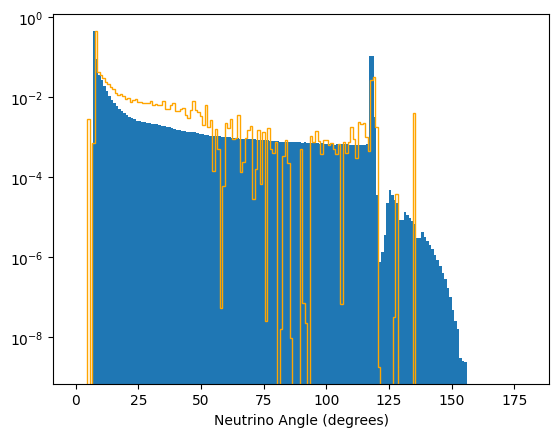

In [91]:
plt.bar(NuMI_angle_bins, NuMI_angle_dist/np.sum(NuMI_angle_dist), width=1)
plt.hist(df['neutrino_angle'], histtype='step', bins = NuMI_angle_bins, color='orange', weights = df['w_event_rate'], density=True)
plt.yscale('log')
plt.xlabel('Neutrino Angle (degrees)')
plt.show()

In [88]:
scale_mc = len(df['distance'].values)
scale_numi = np.sum(baseline_hist)

factor = scale_mc/scale_numi

Text(0.5, 0, 'Distance (cm)')

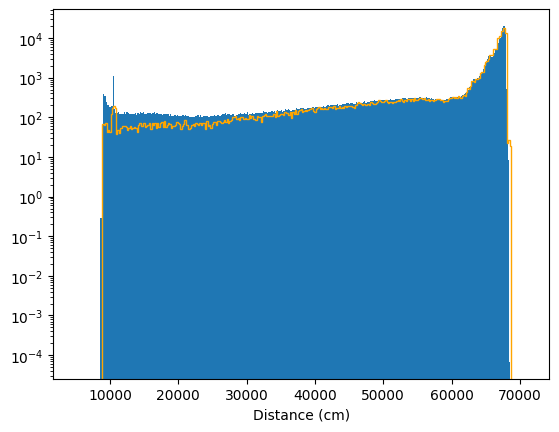

In [89]:
baseline_centres = (baseline_bins[1:] + baseline_bins[:-1]) / 2 * 100
plt.bar(baseline_centres, baseline_hist*factor, width=200)

scale_mc = len(df['distance'].values)
scale_numi = np.sum(baseline_hist)

plt.hist(df['distance'].values, histtype='step', bins=baseline_centres, color='orange', density=False)
plt.yscale('log')
plt.xlabel('Distance (cm)')

## Using Example 4 (Old) with NuMI Geometry

In [30]:
from DarkNews import GenLauncher
import seaborn as sns

import ToyAnalysis as ta
import ToyAnalysis.analysis as a
import ToyAnalysis.analysis_decay as an

In [23]:
kwargs = {  
        'neval': 1e4,
        'HNLtype': 'dirac',
        # 'hepevt': True,
        # 'unweighted_hep_events': 1000,
        # 'hep_unweight': True,
        'experiment': 'microboone_numi_fhc',
        'nopelastic': True,
        'pandas': False,
        'loglevel': 'WARNING'
        }

gen_object = GenLauncher(mzprime=0.030, m4=0.150, **kwargs)
gen_object.run()
df1 = gen_object.df

gen_object = GenLauncher(mzprime=1.25, m4=0.150, **kwargs)
gen_object.run()
df2 = gen_object.df

gen_object = GenLauncher(mzprime=0.03, m5=0.150, m4=0.107, **kwargs)
gen_object.run()
df3 = gen_object.df

gen_object = GenLauncher(mzprime=1.25, m5=0.150, m4=0.107, **kwargs)
gen_object.run()
df4 = gen_object.df

Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.
Directory tree for this run already exists. Overriding it.


In [24]:
microboone_NuMI_geometry(df1)
microboone_NuMI_geometry(df2)
microboone_NuMI_geometry(df3)
microboone_NuMI_geometry(df4)

Intended: 18593, Random: 24, NaN: 0


/var/folders/wr/yb1fjkjn1mbg644j5v7f2tlm0000gp/T/ipykernel_2184/1248859293.py:82: RuntimeWarning:

invalid value encountered in arcsin



Intended: 17778, Random: 128, NaN: 4


/var/folders/wr/yb1fjkjn1mbg644j5v7f2tlm0000gp/T/ipykernel_2184/1248859293.py:82: RuntimeWarning:

invalid value encountered in arcsin



Intended: 18443, Random: 191, NaN: 5
Intended: 17824, Random: 84, NaN: 5


/var/folders/wr/yb1fjkjn1mbg644j5v7f2tlm0000gp/T/ipykernel_2184/1248859293.py:82: RuntimeWarning:

invalid value encountered in arcsin



In [25]:
# we get crazy numbers because we didn't set the couplings to reasonable values

print(f"Total upscattering events for BP1 {df1['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP2 {df2['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP3 {df3['w_event_rate'].sum():.2E}")
print(f"Total upscattering events for BP4 {df4['w_event_rate'].sum():.2E}")

Total upscattering events for BP1 7.06E+05
Total upscattering events for BP2 3.63E+00
Total upscattering events for BP3 7.10E+05
Total upscattering events for BP4 4.03E+00


In [27]:
# we set some useful parameters and compute which events occur in the active detector of MicroBooNE

df1 = an.set_params(df1)
df2 = an.set_params(df2)
df3 = an.set_params(df3)
df4 = an.set_params(df4)

df1_decay = an.decay_selection(df1, l_decay_proper_cm = df1.attrs['N4_ctau0'], experiment='microboone')
df2_decay = an.decay_selection(df2, l_decay_proper_cm = df2.attrs['N4_ctau0'], experiment='microboone')
df3_decay = an.decay_selection(df3, l_decay_proper_cm = df3.attrs['N5_ctau0'], experiment='microboone')
df4_decay = an.decay_selection(df4, l_decay_proper_cm = df4.attrs['N5_ctau0'], experiment='microboone')

#### Looking at the geometry of the scattering positions: XY plane

/Users/user/miniconda3/envs/DarkNews310/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning:

divide by zero encountered in log10



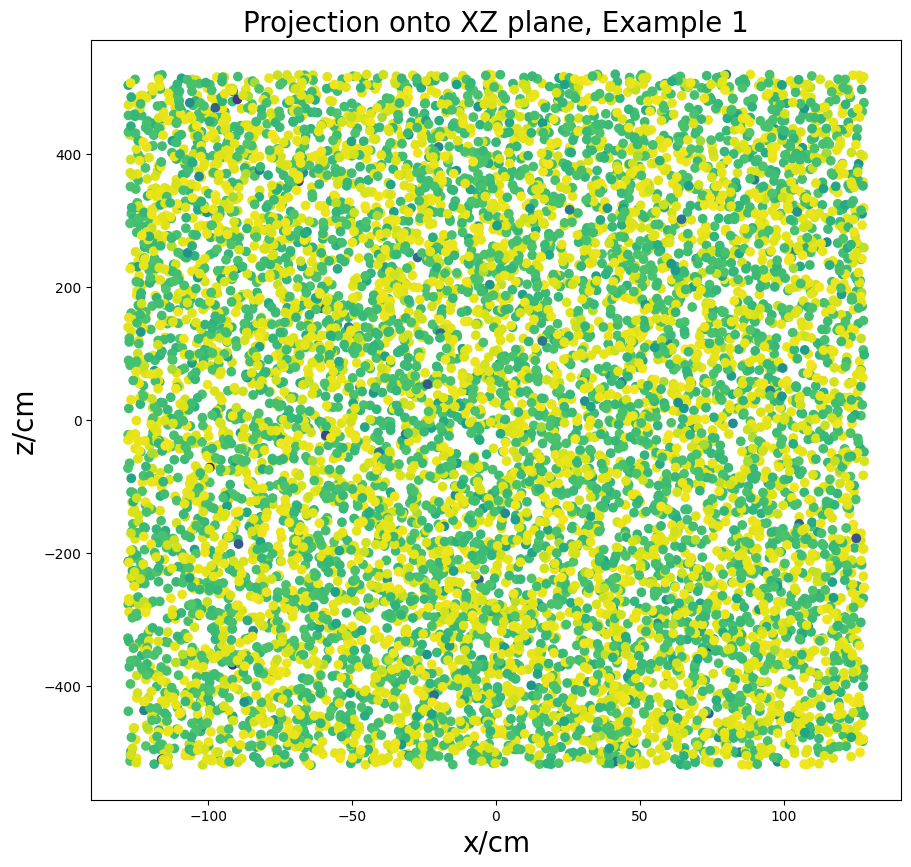

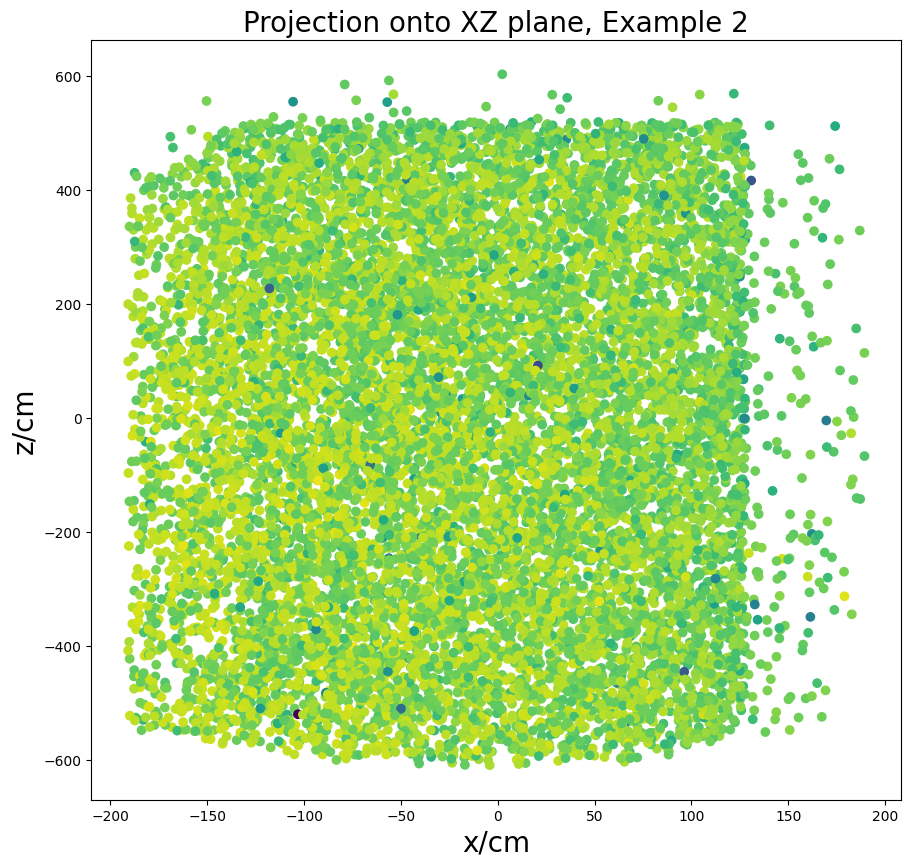

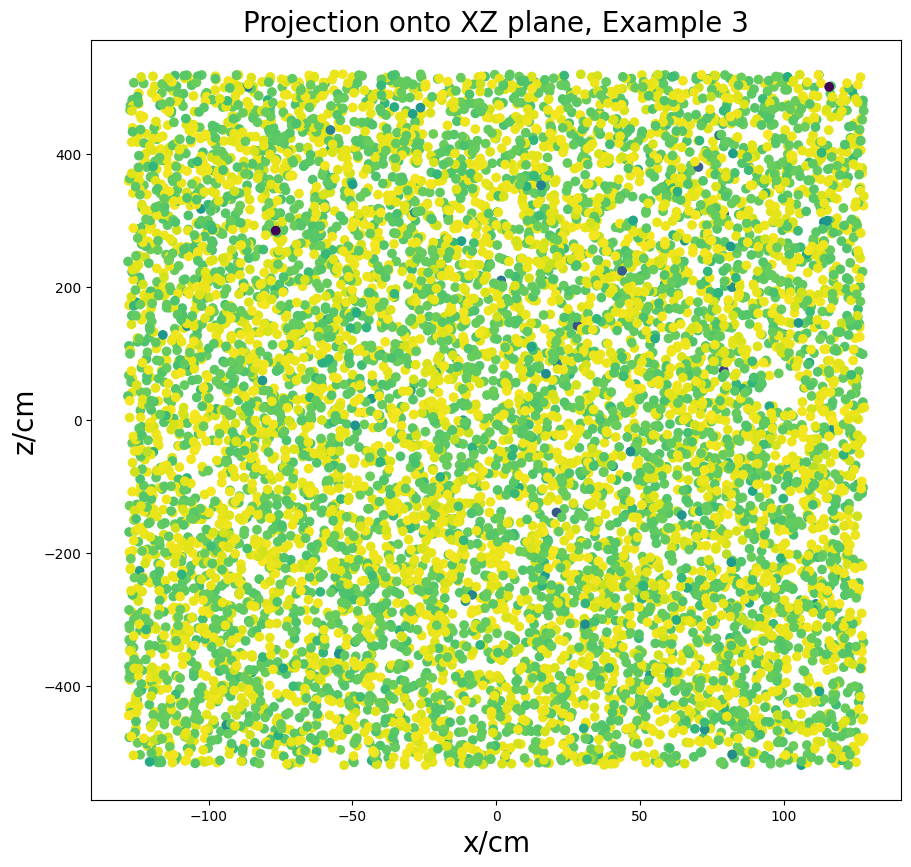

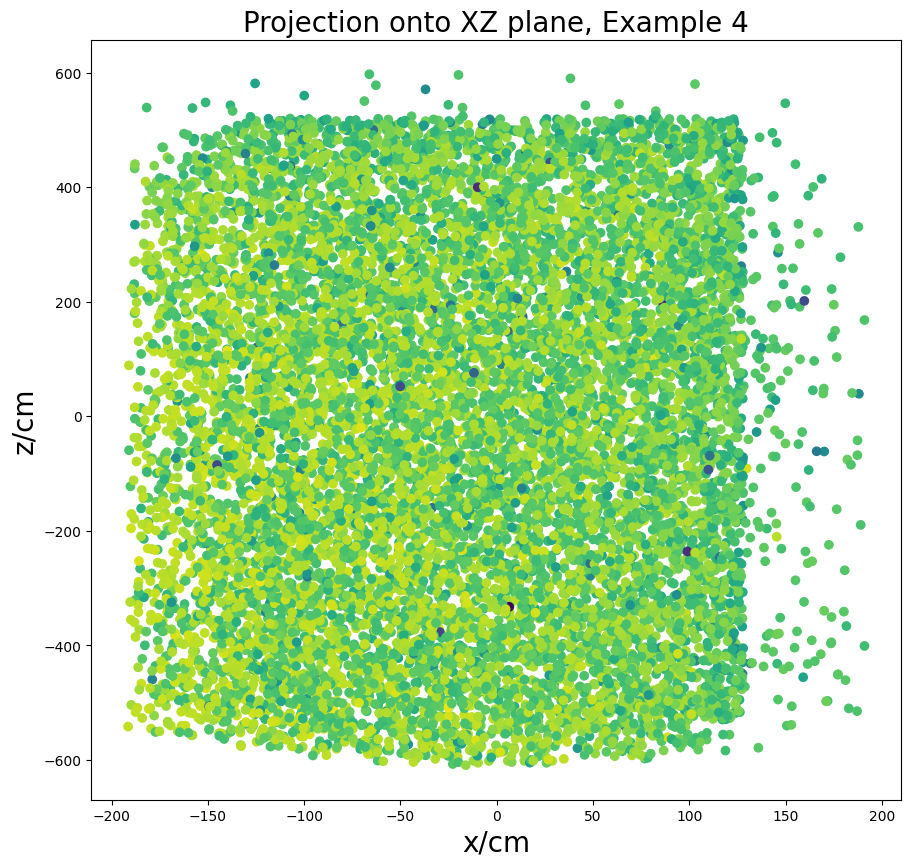

In [28]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto XZ plane, Example " + bp
    xlabel = r'x/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    plt.scatter(df_scat['pos_scatt','1'], df_scat['pos_scatt','3'], c=np.log10(df_scat['w_event_rate']))
    ax.set_title(title,   fontsize=20)
    ax.set_xlabel(xlabel, fontsize=20)
    ax.set_ylabel(ylabel, fontsize=20)

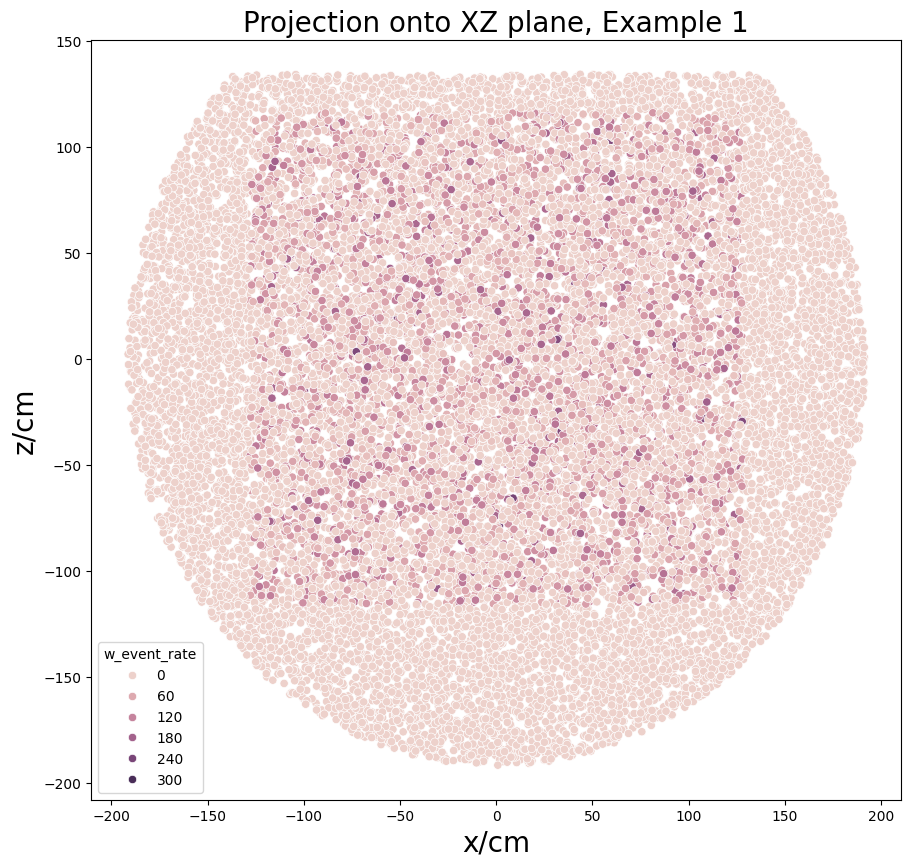

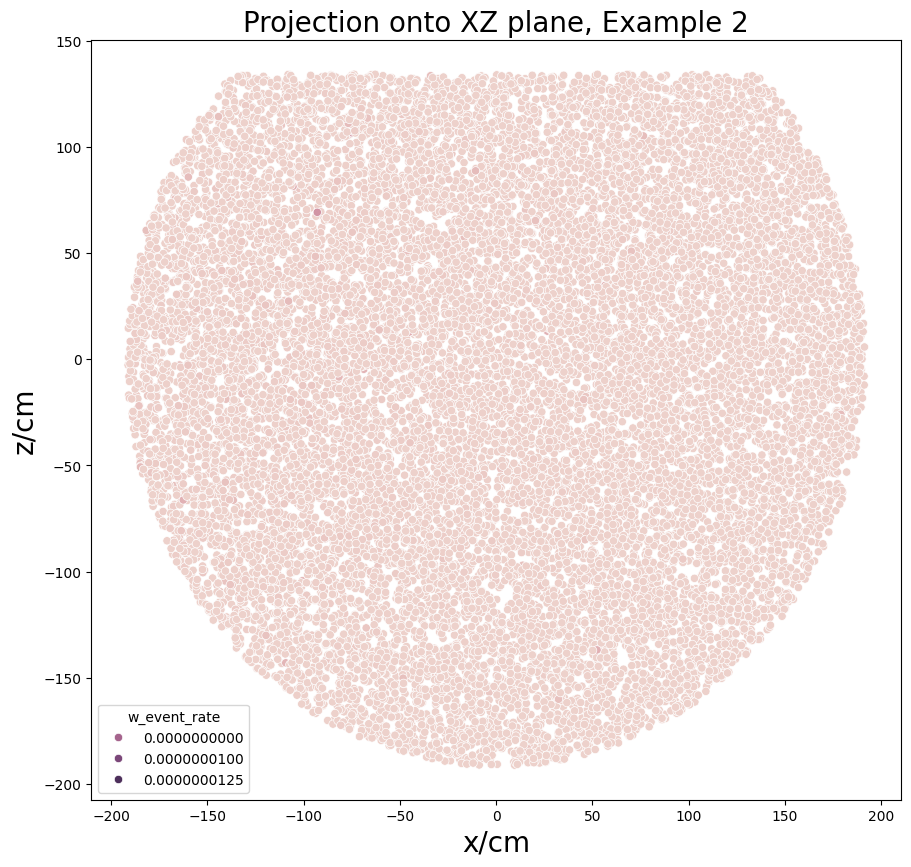

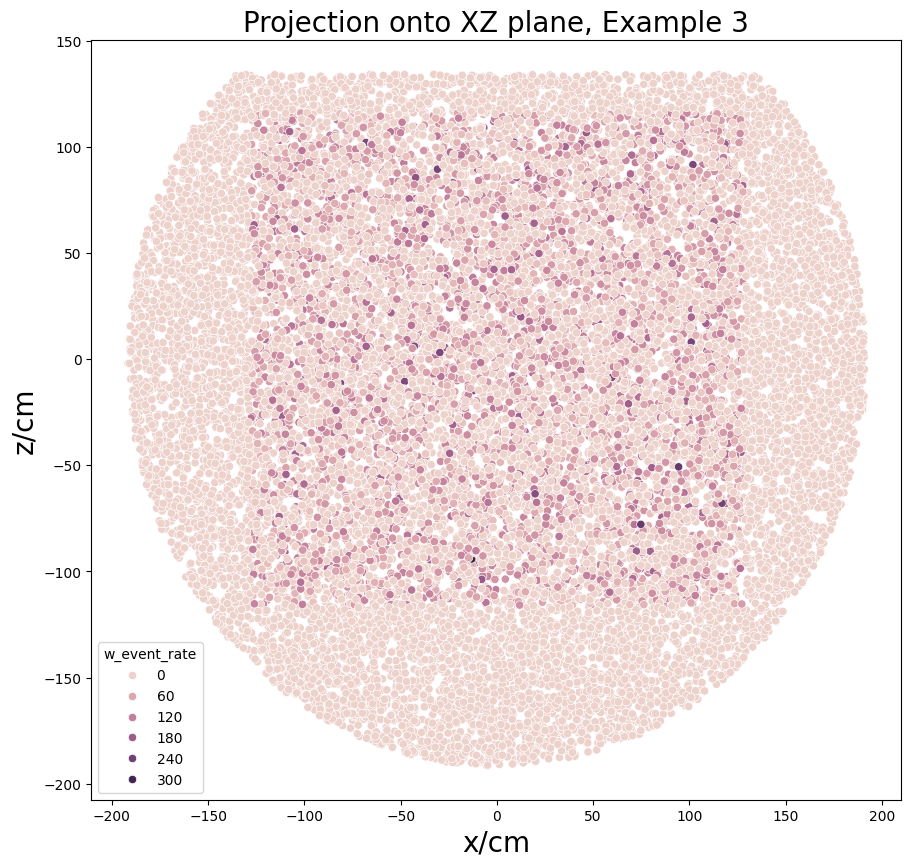

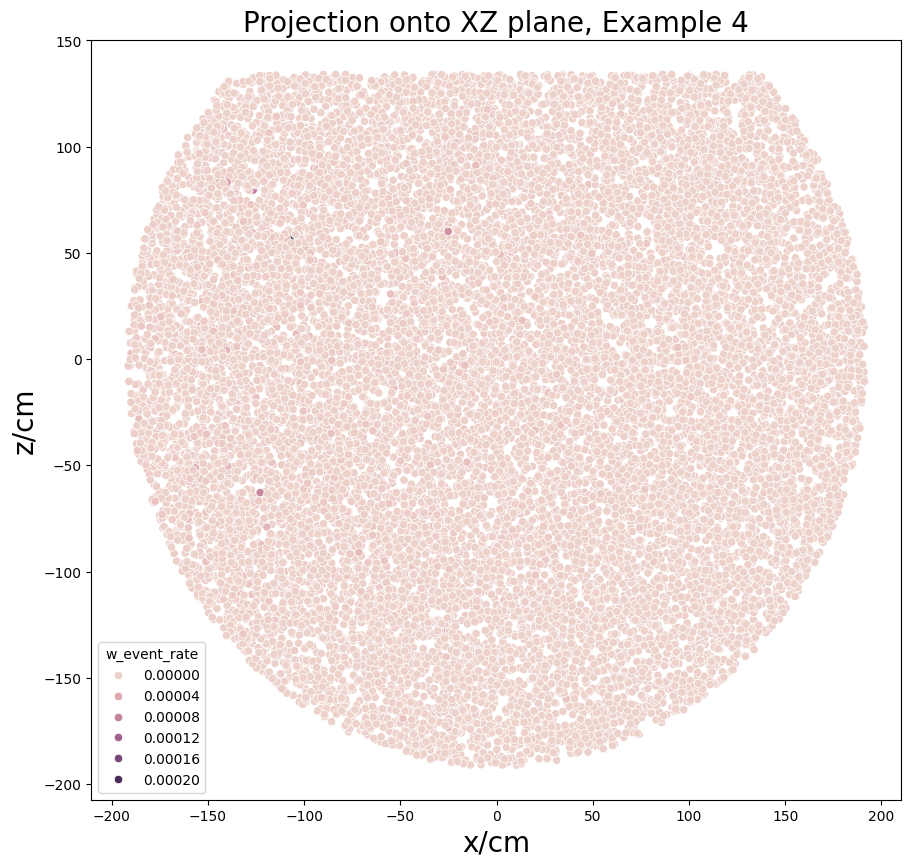

In [31]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto XZ plane, Example " + bp
    xlabel = r'x/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)

    sns.scatterplot(df_scat, x= ('pos_scatt','1'), y=('pos_scatt','2'), hue=('w_event_rate')) #['pos_scatt', '1'], df_scat['pos_scatt', '3'], hue=df_scat['w_event_rate'])
    ax.set_title(title,   fontsize=20)
    ax.set_xlabel(xlabel, fontsize=20)
    ax.set_ylabel(ylabel, fontsize=20)

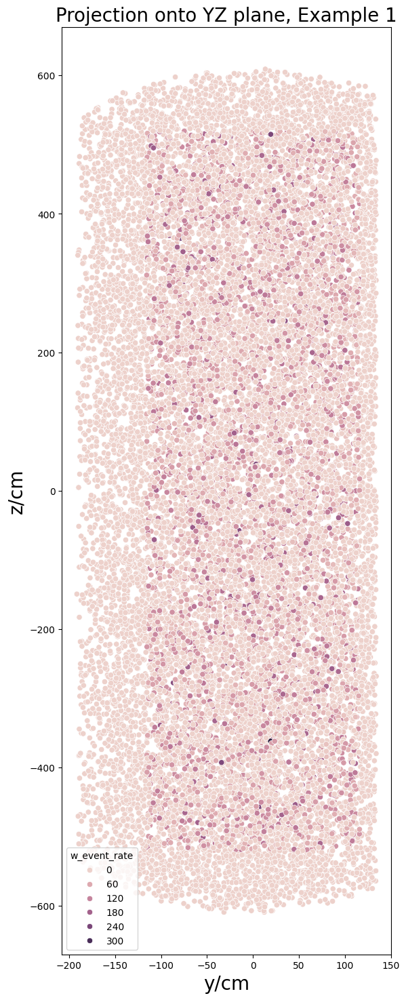

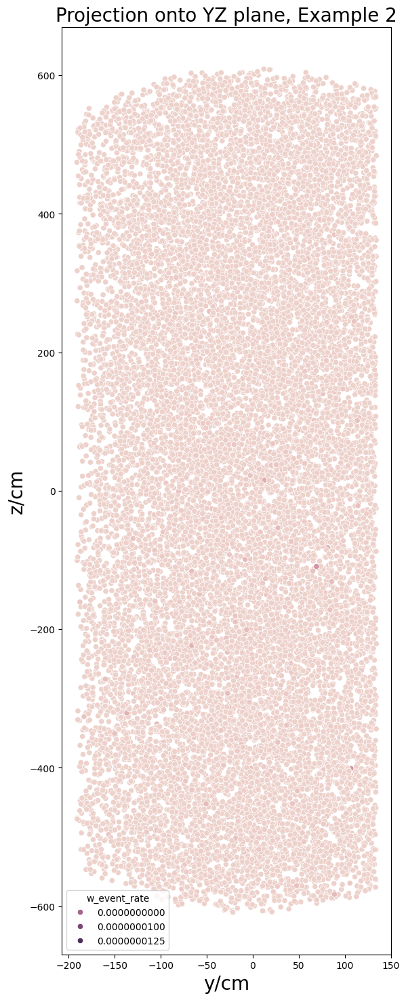

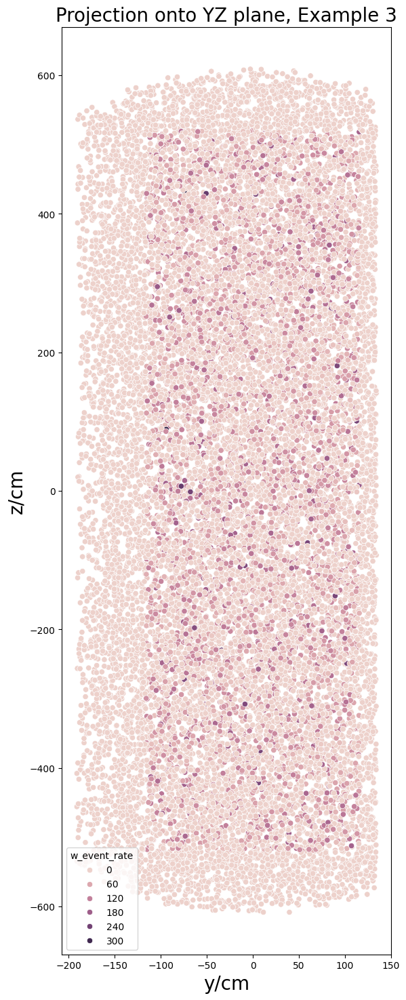

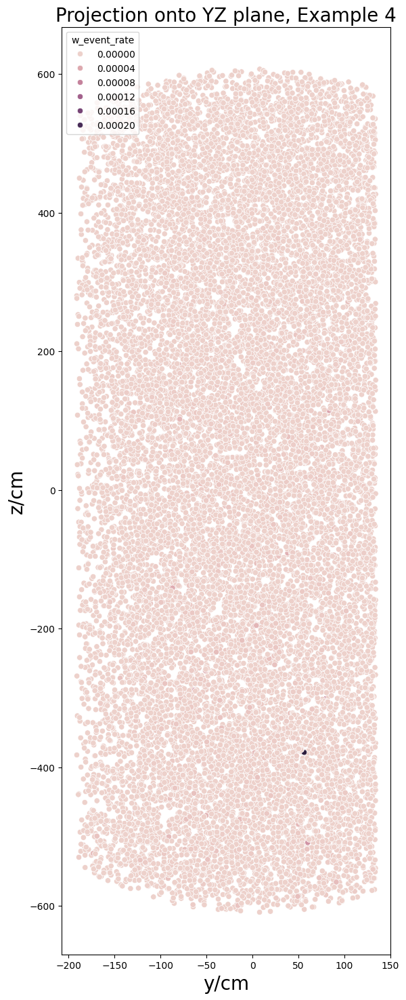

In [32]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Projection onto YZ plane, Example " + bp
    xlabel = r'y/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(6,18))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    
    sns.scatterplot(df_scat, x=('pos_scatt', '2'), y=('pos_scatt', '3'), hue=('w_event_rate'))    
    
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)

## Decay position

Considering points with a short and very long lifetimes.

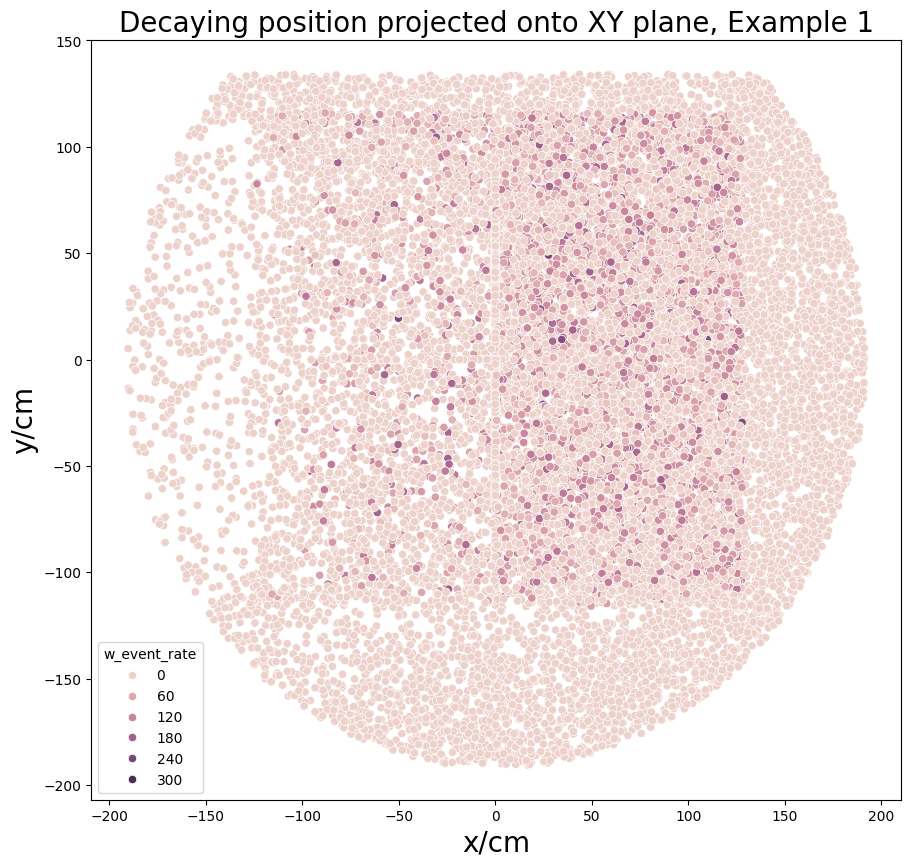

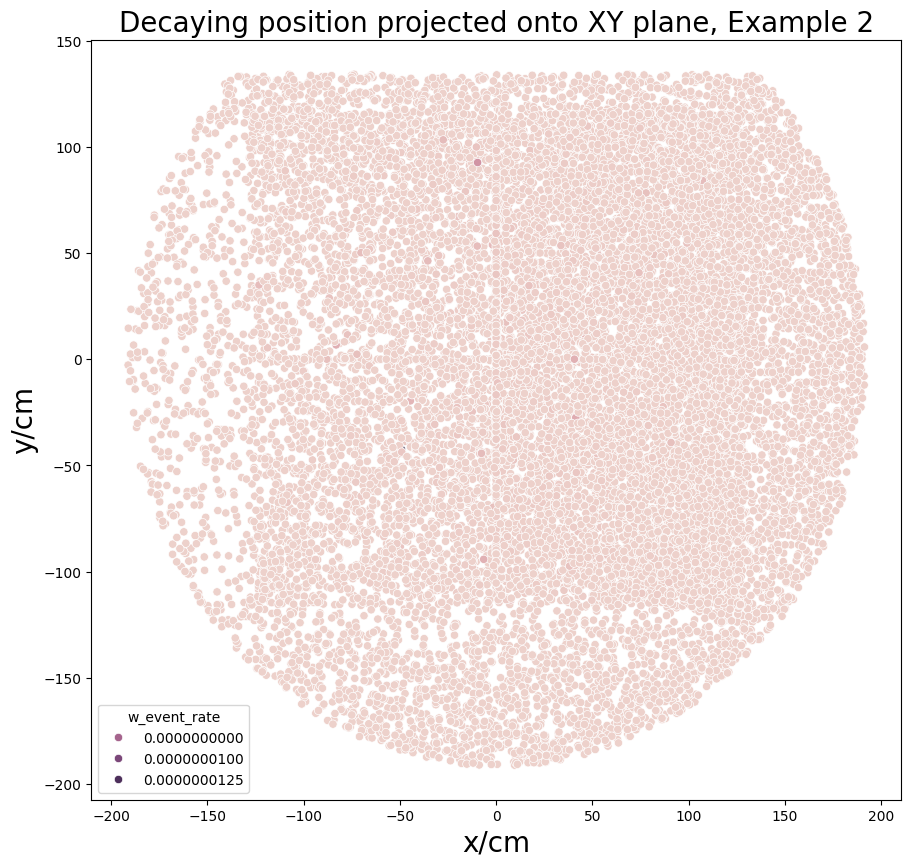

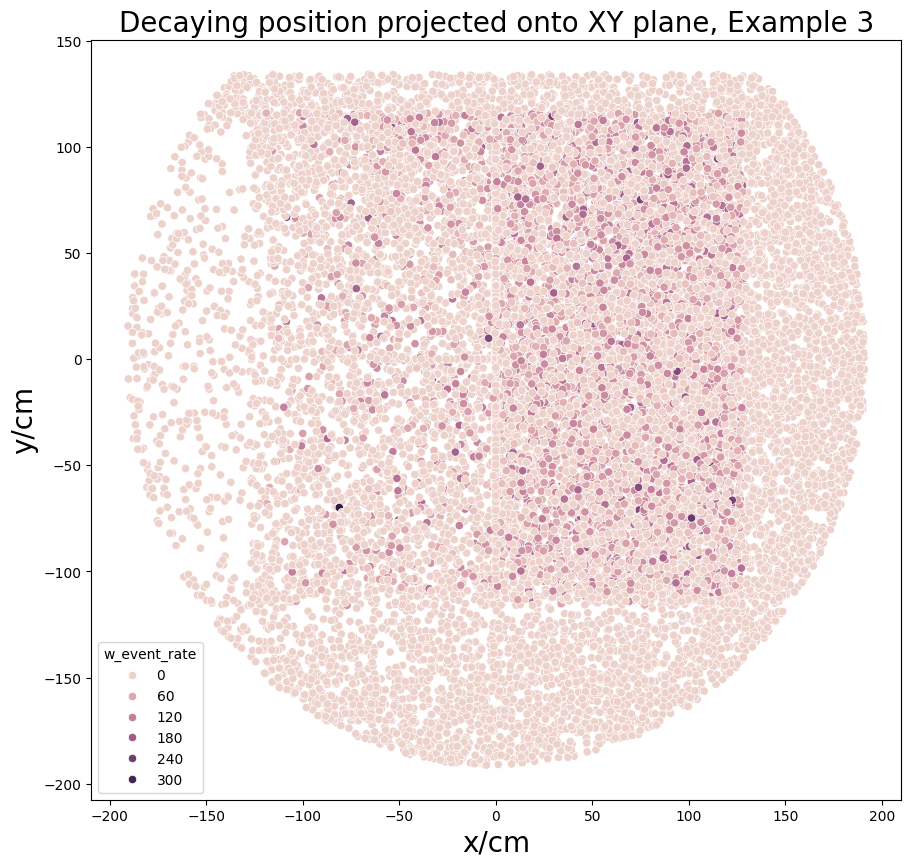

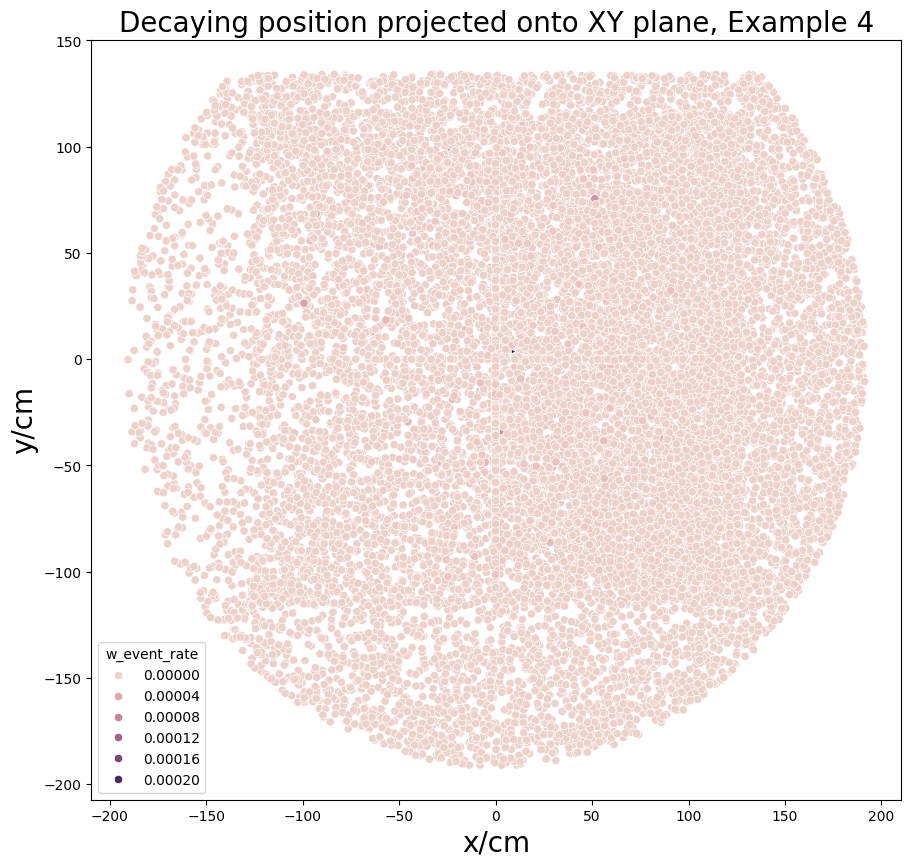

In [33]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Decaying position projected onto XY plane, Example "+bp
    xlabel = r'x/cm'
    ylabel = r'y/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    sns.scatterplot(df_scat, x=('pos_decay', '1'), y=('pos_decay', '2'), hue=('w_event_rate'))
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)

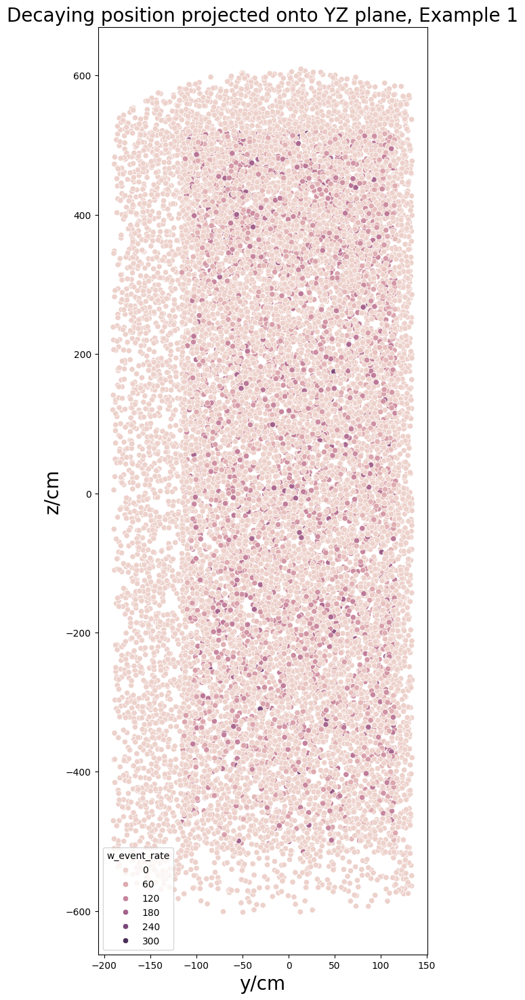

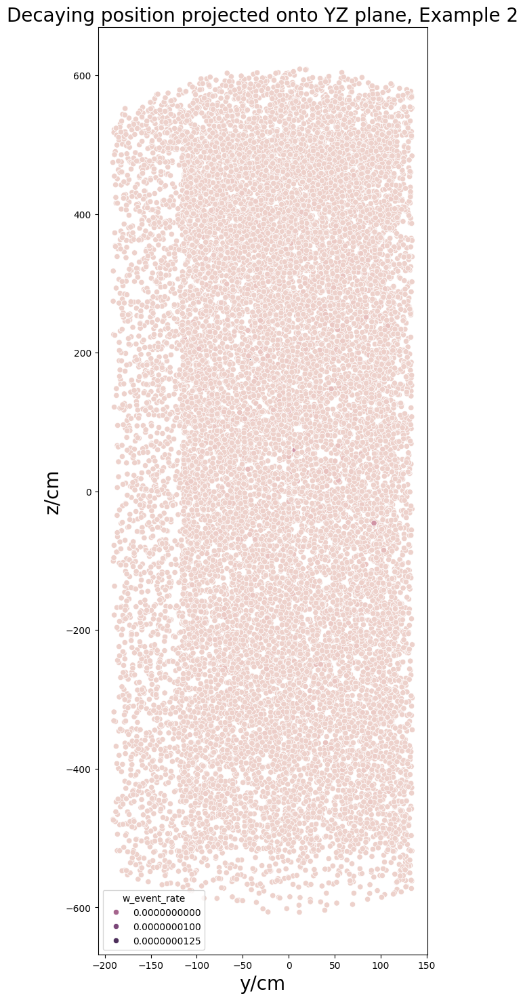

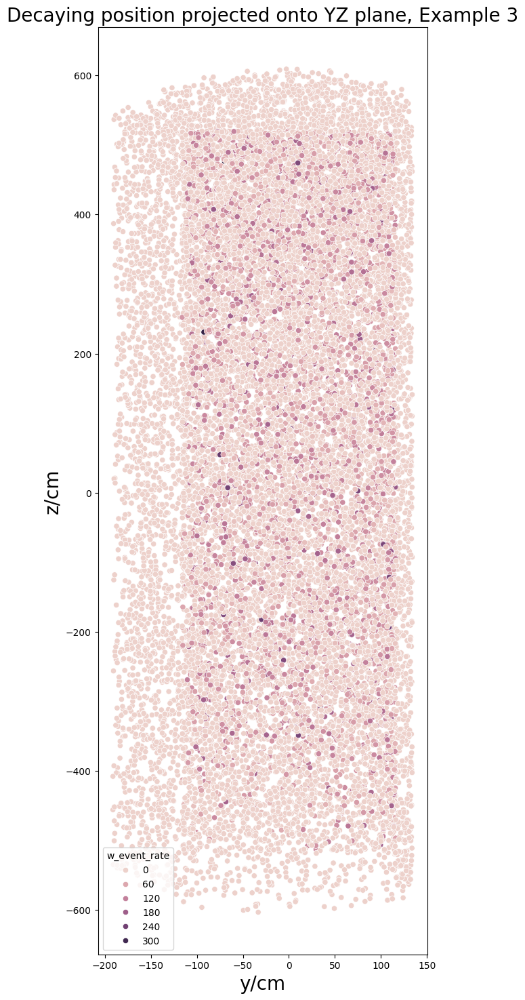

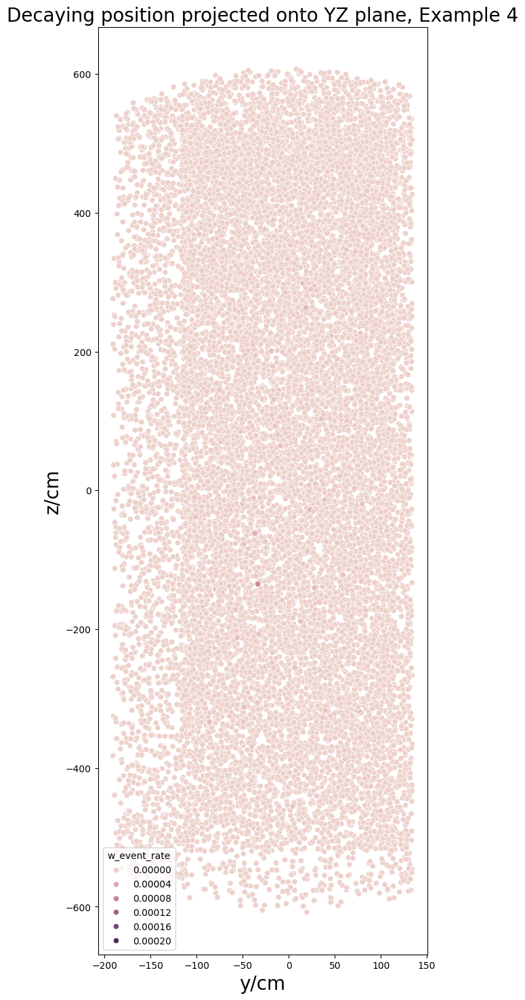

In [34]:
bp_list = ['1','2','3','4']
df_list = [df1_decay,df2_decay,df3_decay,df4_decay]

for case in range(4):
    bp = bp_list[case]
    df_scat = df_list[case].copy(deep=True)
    title = r"Decaying position projected onto YZ plane, Example "+bp
    xlabel = r'y/cm'
    ylabel = r'z/cm'
    
    axes_form  =[0.16,0.16,0.81,0.76]
    fig = plt.figure(figsize=(6,18))
    ax = fig.add_axes(axes_form, rasterized=False)
    ax.patch.set_alpha(0.0)
    sns.scatterplot(df_scat, x=('pos_decay', '2'), y=('pos_decay', '3'), hue=('w_event_rate')) 
    ax.set_title(title,fontsize=20)
    ax.set_xlabel(xlabel,fontsize=20)
    ax.set_ylabel(ylabel,fontsize=20)

In [35]:
df_scat.columns.levels[0]

Index(['P_decay_N_daughter', 'P_decay_N_parent', 'P_decay_ell_minus',
       'P_decay_ell_plus', 'P_projectile', 'P_recoil', 'P_target',
       'w_decay_rate_0', 'w_event_rate', 'target_pdgid', 'projectile_pdgid',
       'w_flux_avg_xsec', 'target', 'scattering_regime', 'helicity',
       'underlying_process', 'h_projectile', 'h_parent', 'pos_scatt',
       'pos_decay', 'distance', 'pos_prod', 'neutrino_angle',
       'reco_theta_beam', 'reco_Evis', 'reco_w', 'reco_Enu', 'w_pre_decay'],
      dtype='object')

In [68]:
import plotly.subplots
import plotly.graph_objs as go


def vector_plotting(df, label, step=10, weight = 'w_event_rate', scale='Viridis'):
    fig = go.Scatter3d(x=df[label, '1'].values[::step], y=df[label, '2'].values[::step], z=df[label, '3'].values[::step], mode='markers', opacity=0.5, name=label, )
                                #    marker_color=df[weight].values[::step], marker_colorscale=scale, name=label)
    return fig

labels = ['P_projectile', 'P_recoil']

fig= go.Figure()

colour_scale = ['Viridis', 'Inferno', 'Magma', 'Cividis', 'Plasma', 'Turbo', 'Jet']

i=0
step = 100

for label in labels:
    scale = colour_scale[i]
    trace = vector_plotting(df1_decay, label, step=step, scale=scale)
    fig.add_trace(trace)
    i+=1
fig.show()

## Intial implementation of uBooNE geometry

In [26]:
# MicroBooNE geometry
z_muB = 1040.
x_muB = 256.
y_muB = 232.

def microboone_numi_tpc_geometry(df):
    # geometry of cylinder_MB for dirt
    length_events = len(df)
    z0 = np.random.random(length_events)*(z_muB) - z_muB/2.

    # # Sampling from the energy distribution
    # bin_centres_5MeV = (bin_edges_5MeV[1:] + bin_edges_5MeV[:-1]) / 2
    # weights_5MeV = NuMI_5MeV_flux/np.sum(NuMI_5MeV_flux)
    # df["P_projectile","0"] = np.random.choice(bin_centres_5MeV, num_events, p=weights_5MeV)

    time = uBNuMIGlobalTimeOffset + (uBNuMIRandomTimeOffset) * np.random.rand(length_events)
    df["pos_scatt", "0"] = time + (z0)/const.c_LIGHT*1e9 # z0 is negative
    df["pos_scatt", "1"] = np.random.random(length_events)*(x_muB) - x_muB/2.
    df["pos_scatt", "2"] = np.random.random(length_events)*(y_muB) - y_muB/2.
    df["pos_scatt", "3"] = z0
    
    # Sample from the angle distribution to get the production point

    n_angle_bins = 180

    angle_bins = np.searchsorted(NuMI_angle_bins, np.random.random(length_events), side='right')-1

    if (n_angle_bins in angle_bins):
        mask = angle_bins >= n_angle_bins
        angle_bins[mask] = n_angle_bins - 1

    weights_angle = NuMI_angle_dist/np.sum(NuMI_angle_dist)
    neutrino_angle  = np.random.choice(NuMI_angle_bins, length_events, p = weights_angle)

    df["neutrino_angle"] = neutrino_angle

    scatt_pos = np.array([df["pos_scatt", "1"].values, df["pos_scatt", "2"].values, df["pos_scatt", "3"].values]).T

    prod_point = find_prod_point(neutrino_angle, scatt_pos)

    u_normal = np.random.random(length_events)
    phi_normal = np.random.random(length_events) * 2. * np.pi
    r_normal = NuMI_decay_pipe_radius * np.sqrt(u_normal)
    prod_point[:,0] += r_normal * np.cos(phi_normal)
    prod_point[:,1] += r_normal * np.sin(phi_normal)

    prod_point_uB = convert_to_ub_tpc_coords(prod_point)

    df["pos_prod", "1"] = prod_point_uB[:,0]
    df["pos_prod", "2"] = prod_point_uB[:,1]
    df["pos_prod", "3"] = prod_point_uB[:,2]

    baseline = np.sqrt((df["pos_scatt", "1"].values - df["pos_prod", "1"].values)**2 + (df["pos_scatt", "2"].values - df["pos_prod", "2"].values)**2 + (df["pos_scatt", "3"].values - df["pos_prod", "3"].values)**2)

    df["baseline"] = baseline

    # Getting energy from baseline
    # # NuMI_energies_positions, Enu_bin_edges, baseline_bin_edges

    n_Lbins = 100
    baseline_bin_centers = 100*NuMI_distances_nu

    L_bins = np.searchsorted(baseline_bin_centers, baseline, side='right')-1

    if (n_Lbins in L_bins):
        mask = L_bins >= n_Lbins
        L_bins[mask] = n_Lbins - 1

    probs_energy = np.ones_like(NuMI_e_vs_dist.T)
    for i in range(np.shape((probs_energy))[1]):
        arr = np.asarray([NuMI_e_vs_dist[:,L_bins[i]]])
        if arr.sum() != 0:
            probs_energy[i] = arr
    
    E_nu = np.array([choice(NuMI_energy_nu, 1, p=probs_energy[L_bins[i]] / probs_energy[L_bins[i]].sum())[0] for i in range(length_events)])
    df["P_projectile","0"] = E_nu

    # RESCALE WEIGHTS
    # rescale the weights with respect to the distance
    # l_baseline_muB - origin is the distance from the horn to the production point
    # try using NuMI_decay_pipe_length - beamline_intersection[:,2] instead ???
    
    distance_weight = ((NuMI_full_length - prod_point[:,2]) / baseline)**2
    df['distance_weight'] = distance_weight

    df.w_event_rate *= distance_weight
    
    # rescaling with respect to angle
    
    p_vec = np.array([df["pos_scatt", "1"].values - df["pos_prod", "1"].values, df["pos_scatt", "2"].values - df["pos_prod", "2"].values, df["pos_scatt", "3"].values - df["pos_prod", "3"].values]).T
    p_vec = p_vec / np.linalg.norm(p_vec, axis=1)[:,None]
  
    BNB_vec = np.array([0,0,1])

    theta_nu = np.arccos(np.dot(p_vec, BNB_vec))
    theta_nu = np.rad2deg(theta_nu)
    df["BNB_theta"] = theta_nu

    e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu, side='right')-1
    n_ebins = len(NuMI_fluxes)
    if (n_ebins in e_bins):
        mask = e_bins >= n_ebins
        e_bins[mask] = n_ebins - 1

    # Not sure this is the correct angle distribution???, dont see the 20 or 120 deg peaks    
    th_bins = np.searchsorted(NuMI_th_bins_angle, neutrino_angle, side='right')-1
    n_ebins = len(NuMI_fluxes[0])
    if (n_ebins in e_bins):
        mask = e_bins >= n_ebins
        th_bins[mask] = n_ebins - 1
    
    renorm_flux_angle = np.array([NuMI_fluxes[e_bins[i],th_bins[i]] for i in range(length_events)])/NuMI_fluxes.sum()
    # df['angle_weight'] = renorm_flux_angle*100
    # df.w_event_rate *= renorm_flux_angle

    df = rotate_dataframe(df)
    

In [115]:
kwargs_numi = {  
        'neval': 1e4,
        'HNLtype': 'dirac',
        # 'hepevt': True,
        # 'unweighted_hep_events': 1000,
        # 'hep_unweight': True,
        'experiment': 'microboone_numi_fhc',
        'nopelastic': True,
        'pandas': False,
        'loglevel': 'WARNING'
        }

kwargs_bnb = {  
        'neval': 1e4,
        'HNLtype': 'dirac',
        # 'hepevt': True,
        # 'unweighted_hep_events': 1000,
        # 'hep_unweight': True,
        'experiment': 'microboone_numi_fhc',
        'nopelastic': True,
        'pandas': False,
        'loglevel': 'WARNING'
        }

gen_object = GenLauncher(mzprime=0.030, m4=0.150, **kwargs_numi)
gen_object.run()
test_df = gen_object.df
# microboone_numi_tpc_geometry(test_df)

gen_object = GenLauncher(mzprime=0.030, m4=0.150, **kwargs_bnb)
gen_object.run()
ub_df = gen_object.df
ub_events = dn.geom.microboone_geometry(ub_df)

Directory tree for this run already exists. Overriding it.


Directory tree for this run already exists. Overriding it.


In [268]:
df = df
vector3d_label = 'P_projectile'

fig = px.scatter_3d(x=df[vector3d_label, '1'].values, y=df[vector3d_label, '2'].values, z=df[vector3d_label, '3'].values, color=df['w_event_rate'].values, opacity=0.5)
# fig.add_scatter3d(x=df['pos_prod', '1'].values, y=df['pos_prod', '2'].values, z=df['pos_prod', '3'].values)
fig.show()

In [71]:
microboone_numi_tpc_geometry(test_df)

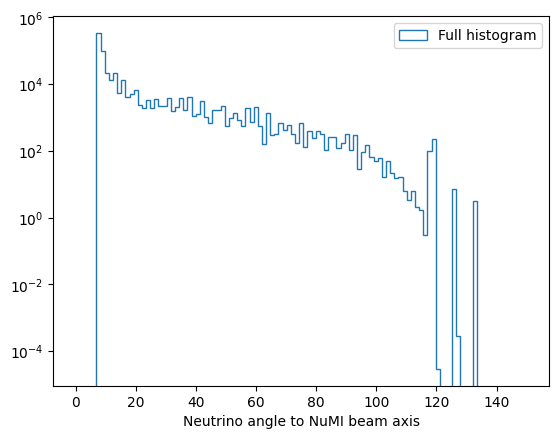

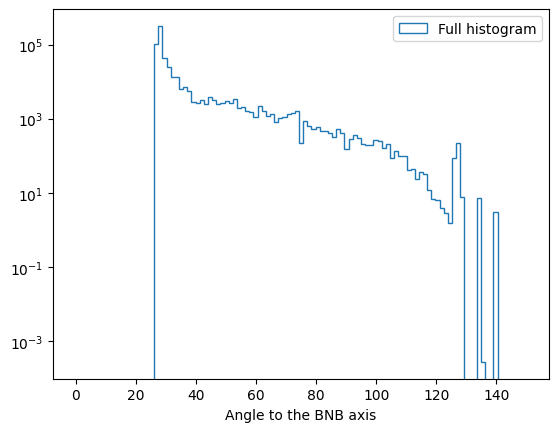

In [74]:
angle_bins = np.linspace(0,150,110)

theta_nu = test_df["neutrino_angle"].to_numpy()
weights=  test_df["w_event_rate"].to_numpy()

plt.hist((theta_nu),angle_bins, histtype='step', weights=weights, label='Full histogram')
plt.legend()
plt.xlabel('Neutrino angle to NuMI beam axis')
plt.yscale('log')
plt.show()



theta_nu = test_df["BNB_theta"].to_numpy()
plt.hist(theta_nu,angle_bins, histtype='step', weights=weights, label='Full histogram')
plt.legend()
plt.xlabel('Angle to the BNB axis')
plt.yscale('log')
plt.show()

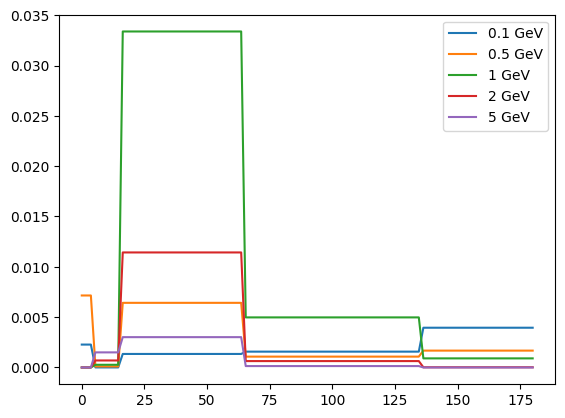

In [60]:
energies = [0.1,0.5,1,2,5]
neutrino_angle = np.linspace(0,180,100)
length_events = len(neutrino_angle)
arr = []

for energy in energies:
    E_nu = np.ones_like(neutrino_angle)*energy
    e_bins = np.searchsorted(NuMI_e_bins_angle, E_nu, side='right')-1

    th_bins = np.searchsorted(NuMI_th_bins_angle, neutrino_angle, side='right')-1
    n_ebins = len(NuMI_fluxes[0])
    if (n_ebins in e_bins):
        mask = e_bins >= n_ebins
        th_bins[mask] = n_ebins - 1

    renorm_flux_angle = np.array([NuMI_fluxes[e_bins[i],th_bins[i]] for i in range(length_events)])/NuMI_fluxes.sum()
    arr.append(renorm_flux_angle)
    plt.plot(neutrino_angle,renorm_flux_angle, label = f'{energy} GeV')
plt.legend()